In [1]:
import numpy as np
from sklearn.cluster import KMeans
from scipy.special import gamma

In [ ]:
def calcular_a(t, T_max):
    # a_max = -1
    # a_min = -2
    # La tasa de decaimiento es de 1 / T_max
    
    a = -1 - (t * (1 / T_max))
    return a

def ysga(func, m, k, t_max, bounds, alpha, lambd):
    n_dim = len(bounds[0])
    random_matrix = np.random.rand(m, n_dim)
    p = random_matrix * (bounds[1] - bounds[0]) + (bounds[0])
    fitness = [float(func(i)) for i in p]
    best_index = np.argmin(fitness)
    phi_best = p[best_index].copy()
    best_fitness = fitness[best_index]


    # Clusters
    K_means = KMeans(k)
    K_means.fit(p)
    labels = K_means.labels_

    cluster_dict = {}
    for idx, label in enumerate(labels):
        cluster_dict.setdefault(int(label), set()).add(idx)

    best_per_cluster = {}
    for cluster_id, indices in cluster_dict.items():
        best_idx_in_cluster = min(indices, key=lambda idx: fitness[idx])
        best_per_cluster[cluster_id] = (best_idx_in_cluster, fitness[best_idx_in_cluster])

    conteos = {k: len(v) for k, v in cluster_dict.items()}

    # tolerancia por cluster
    q = np.zeros(k)

    t = 0
    while t < t_max:
        b = 1.99 + (0.001 * t / (t_max / 10))
        sigma_u = (
            (gamma(1 + b) * np.sin(np.pi * b / 2)) / 
            (gamma((1 + b) / 2) * b * (2**((b - 1) / 2)))
        )**(1 / b)
        u = np.random.normal(0, sigma_u, size=(m, n_dim))
        v = np.random.normal(0, 1, size=(m, n_dim))
        a = calcular_a(t=t, T_max=t_max)

        for cluster_id in cluster_dict.keys():
            # Update Chaser Fish
            best_cluster_index = best_per_cluster[cluster_id][0]
            best = p[best_cluster_index]
            current_best_fitness = best_per_cluster[cluster_id][1]
            f_best = phi_best.copy()
            if np.all(f_best == best):
                    p[best_cluster_index] = best + alpha * u[best_cluster_index] / ((np.abs(v[best_cluster_index]) ** (1/b)))
            else:
                p[best_cluster_index] = best + alpha * u[best_cluster_index] / ((np.abs(v[best_cluster_index]) ** (1/b))) * (f_best - best)
            # Update blocker fish
            cluster_indices = list(cluster_dict[cluster_id])
            for j in range(conteos[cluster_id]):
                r_rho = np.random.rand()
                rho = a + (1 - a) * r_rho
                r = np.random.uniform(-1,1)
                b_fish = p[cluster_indices[j]]
                D_g = np.abs((r * best) - b_fish)
                if cluster_indices[j] != best_cluster_index:
                    p[cluster_indices[j]] = D_g * np.exp(1 * rho) * np.cos(2 * np.pi * rho) + best         
                else:
                    continue

            new_leader_fitness = float(func(p[best_cluster_index]))
            
            # Verificamos si mejoró (Minimización: menor es mejor)
            if new_leader_fitness < current_best_fitness:
                q[cluster_id] = 0 # Mejoró, reiniciamos contador
                # Actualizamos el registro del mejor del cluster
                best_per_cluster[cluster_id] = (best_cluster_index, new_leader_fitness)
            else:
                q[cluster_id] += 1 # No mejoró, sumamos estancamiento
            
            # Si se estancó demasiado (supera lambda), aplicamos intercambio
            if q[cluster_id] > lambd:
                # Movemos a todo el cluster hacia el promedio con el mejor global
                for idx in cluster_indices:
                    p[idx] = (phi_best + p[idx]) / 2
                q[cluster_id] = 0 # Reiniciar contador tras intercambio
    
        # update index and fitness
        p = np.clip(p, bounds[0], bounds[1])
        fitness = [float(func(i)) for i in p]
        current_best_idx = np.argmin(fitness)
        if fitness[current_best_idx] < best_fitness:
            best_fitness = fitness[current_best_idx]
            phi_best = p[current_best_idx].copy()

        for cluster_id, indices in cluster_dict.items():
            best_idx_in_cluster = min(indices, key=lambda idx: fitness[idx])
            best_per_cluster[cluster_id] = (best_idx_in_cluster, fitness[best_idx_in_cluster])
        
        print(f"Iteration {t+1}/{t_max}, Best Fitness: {best_fitness}")

        t += 1
    best_fitness = func(phi_best)

    return phi_best, best_fitness


         
            

In [31]:
import numpy as np
from sklearn.cluster import KMeans
from scipy.special import gamma

def calcular_a(t, T_max):
    # La lógica original lineal se mantiene
    a = -1 - (t * (1 / T_max))
    return a

def ysga(func, m, k, t_max, bounds, alpha, lambd):
    # Inicialización de constantes y dimensiones
    n_dim = len(bounds[0])
    lb = np.array(bounds[0])
    ub = np.array(bounds[1])
    diff = ub - lb
    
    # 1. Población Inicial Vectorizada
    p = np.random.rand(m, n_dim) * diff + lb
    
    # Evaluación inicial de fitness (List comprehension es rápida para black-box functions)
    fitness = np.array([func(x) for x in p])
    
    # Mejor Global
    best_index = np.argmin(fitness)
    phi_best = p[best_index].copy()
    best_fitness = fitness[best_index]

    # 2. Clustering (KMeans se ejecuta una sola vez)
    kmeans = KMeans(n_clusters=k, n_init=10).fit(p)
    labels = kmeans.labels_ # Array de tamaño (m,) con el ID del cluster

    # Estructuras para control de clusters
    q = np.zeros(k, dtype=int) # Contador de estancamiento
    
    # Identificar mejores por cluster iniciales
    best_per_cluster_idxs = np.zeros(k, dtype=int)
    best_per_cluster_fitness = np.zeros(k)

    # Bucle auxiliar rápido para inicializar líderes de cluster
    for i in range(k):
        cluster_indices = np.where(labels == i)[0]
        if len(cluster_indices) > 0:
            local_best_arg = np.argmin(fitness[cluster_indices])
            real_idx = cluster_indices[local_best_arg]
            best_per_cluster_idxs[i] = real_idx
            best_per_cluster_fitness[i] = fitness[real_idx]

    t = 0
    while t < t_max:
        # --- Cálculo de Parámetros Dinámicos (Escalares) ---
        b = 1.99 + (0.001 * t / (t_max / 10))
        
        # Sigma U
        num = gamma(1 + b) * np.sin(np.pi * b / 2)
        den = gamma((1 + b) / 2) * b * (2**((b - 1) / 2))
        sigma_u = (num / den)**(1 / b)
        
        a_param = calcular_a(t, t_max)
        
        # --- Generación de Ruido Vectorizado ---
        u = np.random.normal(0, sigma_u, size=(m, n_dim))
        v = np.random.normal(0, 1, size=(m, n_dim))
        
        # Preparar arrays para actualizaciones
        # p_new = p.copy() # Opcional si queremos actualización síncrona estricta, pero in-place ahorra memoria
        
        # Obtenemos las posiciones de los líderes de cada partícula
        # leaders_map[i] contiene la posición del líder del cluster al que pertenece la partícula i
        leaders_indices_mapped = best_per_cluster_idxs[labels]
        leaders_pos = p[leaders_indices_mapped] 

        # --- UPDATE CHASER FISH (Líderes de Cluster) ---
        # Solo actualizamos los índices que son líderes
        idxs_leaders = best_per_cluster_idxs
        
        # Chaser Logic Vectorizada
        # Condición: np.all(phi_best == best) -> Simplificado: Distancia a global best casi 0
        # Calculamos término común: alpha * u / |v|^(1/b)
        term_common = alpha * u[idxs_leaders] / (np.power(np.abs(v[idxs_leaders]), 1/b) + 1e-10)
        
        # Diferencia con el mejor global
        diff_global = phi_best - p[idxs_leaders]
        is_global_best = np.all(np.isclose(diff_global, 0), axis=1)
        
        # Aplicamos lógica: Si es global best, solo ruido. Si no, ruido * diferencia.
        # Truco matemático: p_new = p + term * (1 if global else diff)
        # Para mantener exactitud con tu lógica:
        update_step = term_common.copy()
        # Donde NO es el mejor global, multiplicamos por la diferencia
        update_step[~is_global_best] *= diff_global[~is_global_best]
        
        p[idxs_leaders] += update_step

        # --- UPDATE BLOCKER FISH (Resto del cardumen) ---
        # Generamos máscara de NO líderes
        mask_blockers = np.ones(m, dtype=bool)
        mask_blockers[idxs_leaders] = False
        
        if np.any(mask_blockers):
            # Recalculamos parámetros rho para todos (vectorizado)
            r_rho = np.random.rand(np.sum(mask_blockers))
            rho = a_param + (1 - a_param) * r_rho
            r = np.random.uniform(-1, 1, size=np.sum(mask_blockers))
            
            # Líderes correspondientes a estos blockers
            my_leaders = leaders_pos[mask_blockers]
            my_pos = p[mask_blockers]
            
            # Espiral Logarítmica Vectorizada
            # D_g = abs(r * best - b_fish) -> Nota: 'best' aquí es el líder del cluster
            D_g = np.abs((r[:, None] * my_leaders) - my_pos)
            
            # Ecuación: D_g * exp(rho) * cos(2pi*rho) + best
            term_spiral = D_g * np.exp(rho[:, None]) * np.cos(2 * np.pi * rho[:, None])
            p[mask_blockers] = term_spiral + my_leaders

        # --- Límites (Clipping) ---
        p = np.clip(p, lb, ub)
        
        # --- Evaluación de Fitness (Post-Movimiento) ---
        # Evaluamos a todos de nuevo (necesario porque todos se movieron o pudieron moverse)
        fitness = np.array([func(x) for x in p])
        
        # --- Actualización de Mejor Global ---
        current_best_idx = np.argmin(fitness)
        if fitness[current_best_idx] < best_fitness:
            best_fitness = fitness[current_best_idx]
            phi_best = p[current_best_idx].copy()
            
        # --- Lógica de Estancamiento (Clusters) ---
        # Recalculamos líderes de clusters y verificamos mejora
        for i in range(k):
            cluster_indices = np.where(labels == i)[0]
            if len(cluster_indices) == 0: continue
            
            # Encontrar nuevo mejor del cluster
            local_argmin = np.argmin(fitness[cluster_indices])
            new_leader_idx = cluster_indices[local_argmin]
            new_leader_fit = fitness[new_leader_idx]
            
            # Comparar con el registro histórico del cluster
            if new_leader_fit < best_per_cluster_fitness[i]:
                best_per_cluster_fitness[i] = new_leader_fit
                best_per_cluster_idxs[i] = new_leader_idx
                q[i] = 0 # Reset contador
            else:
                q[i] += 1 # Aumentar estancamiento
        
        # --- Intercambio (Exchange) por Estancamiento ---
        # Identificar clusters estancados
        stagnant_clusters = np.where(q > lambd)[0]
        
        if len(stagnant_clusters) > 0:
            # Crear máscara de partículas que pertenecen a clusters estancados
            mask_stagnant = np.isin(labels, stagnant_clusters)
            # Mover hacia el promedio con el mejor global
            p[mask_stagnant] = (phi_best + p[mask_stagnant]) / 2
            # Resetear contadores de esos clusters
            q[stagnant_clusters] = 0
            
            # Nota: No reevaluamos fitness aquí para no duplicar coste computacional, 
            # se evaluarán en la siguiente iteración.
            
        print(f"Iteration {t+1}/{t_max}, Best Fitness: {best_fitness}")
        t += 1

    return phi_best, best_fitness

In [11]:
def ackley_function(x: np.ndarray) -> float:
    """
    Calcula el valor de la función Ackley (problema de minimización).
    El mínimo global es 0, alcanzado en x = (0, 0, ..., 0).
    """
    a = 20
    b = 0.2
    c = 2 * np.pi
    d = len(x)
    sum_sq = np.sum(x**2)
    sum_cos = np.sum(np.cos(c * x))
    term1 = -a * np.exp(-b * np.sqrt(sum_sq / d))
    term2 = -np.exp(sum_cos / d)
    return term1 + term2 + a + np.exp(1)

import numpy as np

def schwefel_function(x: np.ndarray) -> float:
    """
    Schwefel function (minimization). Global minimum at x = 420.9687... with value ~0.
    Typical domain: [-500, 500]^d
    """
    d = len(x)
    return 418.9828872724339 * d - np.sum(x * np.sin(np.sqrt(np.abs(x))))

# Suggested bounds: (-500, 500)
# Example:
# val = schwefel_function(np.zeros(10) + 420.968746)

def michalewicz_function(x: np.ndarray, m: float = 10.0) -> float:
    """
    Michalewicz function (minimization). Highly multimodal; parameter m (usually 10) increases difficulty.
    Typical domain: [0, pi]^d
    """
    i = np.arange(1, len(x) + 1)
    return -np.sum(np.sin(x) * (np.sin(i * x**2 / np.pi))**(2*m))

# Suggested bounds: (0, np.pi)
# Example:
# val = michalewicz_function(np.full(5, 2.2), m=10.0)

def griewank_function(x: np.ndarray) -> float:
    """
    Griewank function (minimization). Global minimum at 0.
    Typical domain: [-600, 600]^d
    """
    sum_term = np.sum(x**2) / 4000.0
    prod_term = np.prod(np.cos(x / np.sqrt(np.arange(1, len(x) + 1))))
    return sum_term - prod_term + 1.0

# Suggested bounds: (-600, 600)
# Example:
# val = griewank_function(np.zeros(10))

def levy_function(x: np.ndarray) -> float:
    """
    Levy (N.13) function (minimization). Complex multimodal landscape.
    Typical domain: [-10, 10]^d
    """
    w = 1 + (x - 1) / 4.0
    term1 = np.sin(np.pi * w[0])**2
    term3 = (w[-1] - 1)**2 * (1 + np.sin(2 * np.pi * w[-1])**2)
    term2 = np.sum((w[:-1] - 1)**2 * (1 + 10 * np.sin(np.pi * w[:-1] + 1)**2))
    return term1 + term2 + term3

# Suggested bounds: (-10, 10)
# Example:
# val = levy_function(np.ones(5))

def rosenbrock_function(x: np.ndarray, a: float = 1.0, b: float = 100.0) -> float:
    """
    Rosenbrock function (minimization). Global minimum at x = [a, a, ..., a] with value 0.
    Typical domain: [-5, 10]^d
    """
    return np.sum(b * (x[1:] - x[:-1]**2)**2 + (a - x[:-1])**2)

# Suggested bounds: (-5, 10)
# Example:
# val = rosenbrock_function(np.ones(10))

In [38]:
# Llamar ysga con la función sphere_function y los parámetros definidos
alpha = 0.5
lambd = 5
t_max = 100000
m = 150
k = 7
n = 40  # Dimensionalidad del problema
bounds = (-5, 10)

# Ajustar bounds para que sea un array de shape (2, n)
bounds_array = np.array([np.full(n, bounds[0]), np.full(n, bounds[1])])

best_sol, best_val = ysga(
    func=rosenbrock_function,
    m=m,
    k=k,
    t_max=t_max,
    bounds=bounds_array,
    alpha=alpha,
    lambd=lambd
)
print("Mejor solución encontrada:", best_sol)
print("Mejor valor (fitness):", best_val)

Iteration 1/100000, Best Fitness: 455456.48619743675
Iteration 2/100000, Best Fitness: 328852.1540569114
Iteration 3/100000, Best Fitness: 165546.7070850137
Iteration 4/100000, Best Fitness: 15953.912191712832
Iteration 5/100000, Best Fitness: 7260.48832894235
Iteration 6/100000, Best Fitness: 5060.820859294608
Iteration 7/100000, Best Fitness: 2090.2948173937134
Iteration 8/100000, Best Fitness: 499.11398386034597
Iteration 9/100000, Best Fitness: 337.03355030428867
Iteration 10/100000, Best Fitness: 175.41721921730908
Iteration 11/100000, Best Fitness: 64.85053993240628
Iteration 12/100000, Best Fitness: 47.400681735375024
Iteration 13/100000, Best Fitness: 46.72667890586948
Iteration 14/100000, Best Fitness: 46.52118838178482
Iteration 15/100000, Best Fitness: 46.52118838178482
Iteration 16/100000, Best Fitness: 44.35350499578542
Iteration 17/100000, Best Fitness: 41.74183398470588
Iteration 18/100000, Best Fitness: 41.47297129227439
Iteration 19/100000, Best Fitness: 40.84062045163

In [119]:
a = np.array([1, 2, 3, 4, 5])
q = np.zeros_like(a)
q

array([0, 0, 0, 0, 0])

In [120]:
# Supón que quieres aumentar en 1 los valores de q en los índices 1 y 3
indices_a_incrementar = [1]
q[indices_a_incrementar] += 1
print(q)

[0 1 0 0 0]


In [89]:
np.random.uniform(-1,1)

0.572210797465913

In [102]:
m = 5
n = 5
k = 3
bounds = [0,5]
random_matrix = np.random.rand(m, n)
random_matrix

array([[0.73737115, 0.58499002, 0.2195666 , 0.99604527, 0.49162084],
       [0.17761781, 0.83378736, 0.6220786 , 0.71818754, 0.77697761],
       [0.96318175, 0.09005687, 0.71532103, 0.50696129, 0.49421431],
       [0.10308375, 0.57429576, 0.18374892, 0.37291908, 0.8266852 ],
       [0.33469433, 0.79053257, 0.80123649, 0.24136565, 0.31501405]])

In [103]:
p = random_matrix * (bounds[1] - bounds[0]) + (bounds[0])
p

array([[3.68685573, 2.92495008, 1.09783299, 4.98022633, 2.45810419],
       [0.88808907, 4.16893678, 3.11039298, 3.59093769, 3.88488807],
       [4.81590873, 0.45028434, 3.57660517, 2.53480647, 2.47107154],
       [0.51541873, 2.87147879, 0.91874459, 1.8645954 , 4.133426  ],
       [1.67347167, 3.95266286, 4.00618243, 1.20682823, 1.57507023]])

In [104]:
fitness = [float(sphere_function(row)) for row in p]
best_index = np.argmin(fitness)
best_fitness = fitness[best_index]
print(fitness)
print(best_index)
print(best_fitness)

[54.19840597111891, 55.83046941645425, 48.71927582138447, 29.917065084688367, 38.41082939585124]
3
29.917065084688367


In [105]:
# Importamos K-Means desde sklearn
from sklearn.cluster import KMeans

kmeans = KMeans(k)

In [106]:
# Ajustamos el modelo KMeans a los datos de los "peces" p
kmeans.fit(p)

# Obtenemos las etiquetas de los clusters para cada pez
labels = kmeans.labels_
cluster_dict = {}
for idx, label in enumerate(labels):
    cluster_dict.setdefault(int(label), set()).add(idx)

print(cluster_dict)

{2: {0, 1, 3}, 0: {2}, 1: {4}}


In [107]:
best_per_cluster = {}
for cluster_id, indices in cluster_dict.items():
    best_idx_in_cluster = min(indices, key=lambda idx: fitness[idx])
    best_per_cluster[cluster_id] = (best_idx_in_cluster, fitness[best_idx_in_cluster])
    print(f"Cluster {cluster_id}: Best Index = {best_per_cluster[cluster_id][0]}, Best Fitness = {best_per_cluster[cluster_id][1]}")

Cluster 2: Best Index = 3, Best Fitness = 29.917065084688367
Cluster 0: Best Index = 2, Best Fitness = 48.71927582138447
Cluster 1: Best Index = 4, Best Fitness = 38.41082939585124


In [108]:
best_per_cluster

{2: (3, 29.917065084688367),
 0: (2, 48.71927582138447),
 1: (4, 38.41082939585124)}

In [109]:
best_per_cluster[1][0]

4

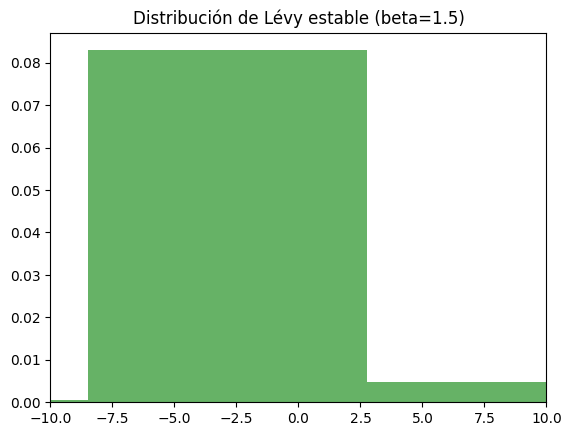

In [110]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import levy_stable

# Parámetros
beta = 1.5  # índice de estabilidad (0 < beta <= 2)
skew = 0    # simétrica (puedes variar entre -1 y 1)
loc = 0     # media
scale = 1   # escala

# Simular 10000 muestras
samples = levy_stable.rvs(beta, skew, loc=loc, scale=scale, size=10000)

# Graficar histograma
plt.hist(samples, bins=200, density=True, alpha=0.6, color='g')
plt.title(f'Distribución de Lévy estable (beta={beta})')
plt.xlim(-10, 10)
plt.show()

In [111]:
from scipy.special import gamma

x = 2.5
valor = gamma(1 + x)
print(f"Gamma(1 + {x}) = {valor}")

Gamma(1 + 2.5) = 3.323350970447843


In [112]:
conteos = {1: 4, 0: 1}
valor = conteos[0]
print(valor)  # Esto imprime 4

1


In [131]:
def ysga_history(func, m, k, t_max, bounds, alpha, lambd):
    n_dim = len(bounds[0])
    random_matrix = np.random.rand(m, n_dim)
    p = random_matrix * (bounds[1] - bounds[0]) + (bounds[0])
    fitness = [float(func(i)) for i in p]
    best_index = np.argmin(fitness)
    phi_best = p[best_index].copy()
    best_fitness = fitness[best_index]

    # Clusters
    K_means = KMeans(k)
    K_means.fit(p)
    labels = K_means.labels_

    cluster_dict = {}
    for idx, label in enumerate(labels):
        cluster_dict.setdefault(int(label), set()).add(idx)

    best_per_cluster = {}
    for cluster_id, indices in cluster_dict.items():
        best_idx_in_cluster = min(indices, key=lambda idx: fitness[idx])
        best_per_cluster[cluster_id] = (best_idx_in_cluster, fitness[best_idx_in_cluster])

    conteos = {k: len(v) for k, v in cluster_dict.items()}
    q = np.zeros(k)
    
    history = [] # Para guardar la posición de los peces en cada iteración

    t = 0
    while t < t_max:
        # Guardar estado actual
        history.append(p.copy())

        b = 1.99 + (0.001 * t / (t_max / 10))
        sigma_u = (
            (gamma(1 + b) * np.sin(np.pi * b / 2)) / 
            (gamma((1 + b) / 2) * b * (2**((b - 1) / 2)))
        )**(1 / b)
        u = np.random.normal(0, sigma_u, size=(m, n_dim))
        v = np.random.normal(0, 1, size=(m, n_dim))
        a = calcular_a(t=t, T_max=t_max)

        for cluster_id in cluster_dict.keys():
            best_cluster_index = best_per_cluster[cluster_id][0]
            best = p[best_cluster_index]
            current_best_fitness = best_per_cluster[cluster_id][1]
            f_best = phi_best.copy()
            
            if np.all(f_best == best):
                    p[best_cluster_index] = best + alpha * u[best_cluster_index] / ((np.abs(v[best_cluster_index]) ** (1/b)))
            else:
                p[best_cluster_index] = best + alpha * u[best_cluster_index] / ((np.abs(v[best_cluster_index]) ** (1/b))) * (f_best - best)
            
            cluster_indices = list(cluster_dict[cluster_id])
            for j in range(conteos[cluster_id]):
                r_rho = np.random.rand()
                rho = a + (1 - a) * r_rho
                r = np.random.uniform(-1,1)
                b_fish = p[cluster_indices[j]]
                D_g = np.abs((r * best) - b_fish)
                if cluster_indices[j] != best_cluster_index:
                    p[cluster_indices[j]] = D_g * np.exp(1 * rho) * np.cos(2 * np.pi * rho) + best         
                else:
                    continue

            new_leader_fitness = float(func(p[best_cluster_index]))
            
            if new_leader_fitness < current_best_fitness:
                q[cluster_id] = 0 
                best_per_cluster[cluster_id] = (best_cluster_index, new_leader_fitness)
            else:
                q[cluster_id] += 1 
            
            if q[cluster_id] > lambd:
                for idx in cluster_indices:
                    p[idx] = (phi_best + p[idx]) / 2
                q[cluster_id] = 0 
    
        p = np.clip(p, bounds[0], bounds[1])
        fitness = [float(func(i)) for i in p]
        current_best_idx = np.argmin(fitness)
        if fitness[current_best_idx] < best_fitness:
            best_fitness = fitness[current_best_idx]
            phi_best = p[current_best_idx].copy()

        for cluster_id, indices in cluster_dict.items():
            best_idx_in_cluster = min(indices, key=lambda idx: fitness[idx])
            best_per_cluster[cluster_id] = (best_idx_in_cluster, fitness[best_idx_in_cluster])

        t += 1
        
    return phi_best, best_fitness, np.array(history), labels

In [132]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Función Rastrigin para probar (es bonita en 3D/2D)
def rastrigin(x):
    A = 10
    return A * len(x) + np.sum(x**2 - A * np.cos(2 * np.pi * x))

# Configuración
m = 50
k = 3
t_max = 100
bounds = (-5.12, 5.12) # Límites típicos de Rastrigin
bounds_array = np.array([np.full(2, bounds[0]), np.full(2, bounds[1])]) # 2D para visualizar

# Ejecutar algoritmo modificado
best_sol, best_val, history, labels = ysga_history(rastrigin, m, k, t_max, bounds_array, alpha=0.5, lambd=5)

# Crear animación
fig, ax = plt.subplots(figsize=(8, 6))
ax.set_xlim(bounds[0], bounds[1])
ax.set_ylim(bounds[0], bounds[1])
ax.set_title("Movimiento de Peces (YSGA) en Función Rastrigin")

# Fondo con contornos de la función
x = np.linspace(bounds[0], bounds[1], 100)
y = np.linspace(bounds[0], bounds[1], 100)
X, Y = np.meshgrid(x, y)
Z = np.array([rastrigin(np.array([xi, yi])) for xi, yi in zip(np.ravel(X), np.ravel(Y))])
Z = Z.reshape(X.shape)
ax.contour(X, Y, Z, levels=20, cmap='viridis', alpha=0.3)

# Puntos de los peces
scat = ax.scatter([], [], c=[], cmap='tab10', s=50)

def update(frame):
    positions = history[frame]
    scat.set_offsets(positions)
    scat.set_array(labels) # Colores por cluster
    ax.set_title(f"Iteración: {frame}/{t_max}")
    return scat,

ani = FuncAnimation(fig, update, frames=len(history), interval=100, blit=True)
plt.close() # Para no mostrar la figura estática inicial

# Mostrar animación en el notebook
HTML(ani.to_jshtml())

Animation size has reached 21239485 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


| Dimension | Pop Size | Function | Py Time (s) | Py Fitness | Rs Time (s) | Rs Fitness | Speedup | Rs Time-Matched (s) | Rs TM Fitness | Improvement (Py/Rs TM) |
|---|---|---|---|---|---|---|---|---|---|---|
| 50 | 100 | sphere | 27.3692 | 4.43E-012 | 0.0488 | 9.75E-014 | 560.84 | 22.6344 | 5.93E-022 | 7.47E+009 |
| 50 | 100 | rastrigin | 20.11 | 8.06E-009 | 0.0527 | 2.63E-011 | 381.59 | 20.0881 | 0.00E+000 | Infinite |
| 50 | 100 | ackley | 20.4764 | 2.50E-006 | 0.0606 | 1.98E-007 | 337.89 | 18.7533 | 1.51E-011 | 1.66E+005 |
| 100 | 120 | sphere | 20.5056 | 1.98E-009 | 0.0579 | 1.94E-014 | 354.16 | 19.9219 | 7.70E-022 | 2.57E+012 |
| 100 | 120 | rastrigin | 20.9184 | 9.75E-008 | 0.0949 | 6.93E-011 | 220.43 | 20.2265 | 0.00E+000 | Infinite |
| 100 | 120 | ackley | 21.402 | 2.05E-005 | 0.1024 | 5.93E-008 | 209.00 | 19.9604 | 1.41E-011 | 1.46E+006 |
| 300 | 150 | sphere | 23.5558 | 4.85E-010 | 0.1247 | 2.00E-013 | 188.90 | 24.857 | 8.63E-022 | 5.62E+011 |
| 300 | 150 | rastrigin | 27.0508 | 1.05E-006 | 0.2752 | 3.12E-009 | 98.30 | 25.1854 | 0.00E+000 | Infinite |
| 300 | 150 | ackley | 24.1477 | 2.50E-006 | 0.2903 | 1.57E-007 | 83.18 | 21.0483 | 6.27E-012 | 3.99E+005 |
| 500 | 200 | sphere | 27.4683 | 5.87E-011 | 0.2448 | 6.87E-012 | 112.21 | 28.884 | 9.60E-022 | 6.12E+010 |
| 500 | 200 | rastrigin | 39.9779 | 1.74E-007 | 0.5855 | 7.89E-008 | 68.28 | 36.3078 | 0.00E+000 | Infinite |
| 500 | 200 | ackley | 29.7089 | 1.85E-006 | 0.5872 | 2.13E-007 | 50.59 | 26.4488 | 6.20E-012 | 2.99E+005 |
